In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import folium

In [2]:
data = pd.read_csv("Airports2.csv")
data.shape

(3606803, 15)

In [3]:
data.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,NaN,NaN
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002


## 1. Flight Network Analysis (Q1)
### The dataset contains information about flights between airports in the United States. You can download and explore the dataset here. In this task, you will analyze the basic features of the flight network graph, such as its size, density, and degree distribution.

## Storing the Airport Data as a Directed Weighted Graph 

In [4]:
flight_network = nx.DiGraph()

for _, row in data.iterrows():
    origin = row['Origin_airport']
    destination = row['Destination_airport']
    passengers = row['Passengers']
    flights = row['Flights']
    distance = row['Distance']
    origin_lat = row['Org_airport_lat']
    origin_long = row['Org_airport_long']
    dest_lat = row['Dest_airport_lat']
    dest_long = row['Dest_airport_long']

    if not flight_network.has_node(origin):
        flight_network.add_node(origin, latitude=origin_lat, longitude=origin_long)

    if not flight_network.has_node(destination):
        flight_network.add_node(destination, latitude=dest_lat, longitude=dest_long)

    flight_network.add_edge(
        origin, destination, 
        passengers=passengers, 
        flights=flights, 
        distance=distance
    )


Your Task:

Implement a function analyze_graph_features(flight_network) that takes the flight network as input and computes the following:

Count the number of airports (nodes) and flights (edges) in the graph.
Compute the density of the graph using the formula: 
$$
\text{Density} = \frac{2 \cdot E}{N \cdot (N - 1)}
$$


Calculate both in-degree and out-degree for each airport and visualize them using histograms.
Identify airports with degrees higher than the 90th percentile and list them as "hubs."

Determine if the graph is sparse or dense based on its density.

Write a function summarize_graph_features(flight_network) that generates a detailed report of the graph's features. A summary report needs to include:


The number of nodes and edges.

The graph density.

Degree distribution plots for in-degree and out-degree.

A table of identified hubs.

Now let's dive deeper into the analysis of the dataset. 

Do the following:

Compute total passenger flow between origin and destination cities.

Identify and visualize the busiest routes by passenger traffic.

Calculate the average passengers per flight for each route and highlight under/over-utilized connections.

Create an interactive map visualizing the geographic spread of the flight network.

In [5]:
def analyze_graph_features(flight_network):
    num_nodes = len(flight_network.nodes)
    num_edges = len(flight_network.edges)

    if num_nodes > 1:
        density = 2 * num_edges / (num_nodes * (num_nodes - 1))
    else:
        density = 0

    in_degrees = {node: 0 for node in flight_network.nodes}
    out_degrees = {node: 0 for node in flight_network.nodes}

    for origin, destination in flight_network.edges:
        out_degrees[origin] += 1
        in_degrees[destination] += 1

    degree_values = [in_degrees[node] + out_degrees[node] for node in flight_network.nodes]
    threshold = np.percentile(degree_values, 90)
    hubs = [node for node in flight_network.nodes if in_degrees[node] + out_degrees[node] > threshold]

    graph_type = "Dense" if density >= 0.5 else "Sparse"

    return {
        "num_nodes": num_nodes,
        "num_edges": num_edges,
        "density": density,
        "graph_type": graph_type,
        "hubs": hubs,
        "in_degrees": in_degrees,
        "out_degrees": out_degrees
    }


## Helper Functions for Question-1

In [6]:
def compute_passenger_flow(flight_network):
    passenger_flow = {}
    for origin, destination, data in flight_network.edges(data=True):
        route = (origin, destination)
        passengers = data['passengers']
        if route not in passenger_flow:
            passenger_flow[route] = 0
        passenger_flow[route] += passengers
    return passenger_flow

def visualize_busiest_routes(passenger_flow):
    sorted_routes = sorted(passenger_flow.items(), key=lambda x: x[1], reverse=True)[:10]
    routes, flows = zip(*sorted_routes)
    route_labels = [f"{r[0]} -> {r[1]}" for r in routes]

    plt.figure(figsize=(12, 6))
    plt.barh(route_labels, flows, color='lightblue')
    plt.xlabel("Passenger Traffic")
    plt.title("Top 10 Busiest Routes by Passenger Traffic")
    plt.gca().invert_yaxis()
    plt.show() 
def compute_average_passenger_per_flight(flight_network):
    avg_passengers = {}
    for origin, destination, data in flight_network.edges(data=True):
        route = (origin, destination)
        passengers = data['passengers']
        flights = data['flights']
        avg_passengers[route] = passengers / flights if flights > 0 else 0
    return avg_passengers

def display_top_routes_by_efficiency(flight_network):
    avg_passengers = compute_average_passenger_per_flight(flight_network)
    sorted_routes = sorted(avg_passengers.items(), key=lambda x: x[1], reverse=True)[:10]
    efficiency_df = pd.DataFrame(
        [(r[0], r[1], f"{p:.2f}") for r, p in sorted_routes],
        columns=["Origin", "Destination", "Avg Passengers per Flight"]
    )
    print("\nTop 10 Routes by Average Passengers per Flight:")
    print(efficiency_df.to_string(index=False))


def visualize_flight_network_on_plot(flight_network, airport_coords):
    plt.figure(figsize=(12, 8))

    # Filter out invalid coordinates
    filtered_coords = {
        node: coords for node, coords in airport_coords.items()
        if coords[0] is not None and coords[1] is not None
    }

    if not filtered_coords:
        print("No valid airport coordinates found for visualization.")
        return

    # Plot edges
    for origin, destination, _ in flight_network.edges(data=True):
        if origin in filtered_coords and destination in filtered_coords:
            orig_coord = filtered_coords[origin]
            dest_coord = filtered_coords[destination]
            plt.plot(
                [orig_coord[1], dest_coord[1]],  # Longitude
                [orig_coord[0], dest_coord[0]],  # Latitude
                color='blue', linewidth=0.5, alpha=0.7
            )
    
    # Plot nodes (airports)
    for airport, coord in filtered_coords.items():
        plt.scatter(coord[1], coord[0], color='red', s=10)  # Longitude, Latitude

    plt.title("Flight Network Visualization")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.show()






In [7]:
from IPython.display import display

def create_interactive_map(flight_network, airport_coords):
    # Filtering out airports with invalid coordinates (NaNs or None)
    cleaned_coords = {
        airport: coord
        for airport, coord in airport_coords.items()
        if coord[0] is not None and coord[1] is not None and not any(c != c for c in coord) 
    }

    if not cleaned_coords:
        print("No valid airport coordinates available for mapping.")
        return None

    # Initialize map at approximate center of the US
    flight_map = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

    # Add flight routes to the map
    for origin, destination, data in flight_network.edges(data=True):
        if origin in cleaned_coords and destination in cleaned_coords:
            orig_coord = cleaned_coords[origin]
            dest_coord = cleaned_coords[destination]
            folium.PolyLine(
                [orig_coord, dest_coord],
                color='blue', weight=0.5, opacity=0.7
            ).add_to(flight_map)

    # Add airport markers
    for airport, coord in cleaned_coords.items():
        folium.CircleMarker(
            location=coord,
            radius=3,
            color='red',
            fill=True,
            fill_opacity=0.6
        ).add_to(flight_map)

    return flight_map


In [8]:
def summarize_graph_features(flight_network):
    features = analyze_graph_features(flight_network)

    print("\n===== Summary Report =====")
    print(f"Total Number of Airports (Nodes): {features['num_nodes']}")
    print(f"Total Number of Flights (Edges): {features['num_edges']}")
    print(f"Graph Density: {features['density']:.4f}")
    print(f"Graph Type: {features['graph_type']}")

    hub_df = pd.DataFrame(features['hubs'], columns=['Hubs'])
    print("\nHubs (Top 10% Airports by Degree):")
    print(hub_df.to_string(index=False))

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.hist(list(features['in_degrees'].values()), bins=30, color='skyblue')
    plt.title("In-degree Distribution")
    plt.xlabel("In-degree")
    plt.ylabel("Frequency")

    plt.subplot(1, 2, 2)
    plt.hist(list(features['out_degrees'].values()), bins=30, color='orange')
    plt.title("Out-degree Distribution")
    plt.xlabel("Out-degree")
    plt.ylabel("Frequency")
    plt.tight_layout()
    plt.show()

    passenger_flow = compute_passenger_flow(flight_network)
    visualize_busiest_routes(passenger_flow)

    avg_passengers = compute_average_passenger_per_flight(flight_network)
    busiest_routes = sorted(avg_passengers.items(), key=lambda x: x[1], reverse=True)[:10]

    busiest_df = pd.DataFrame(
        [(r[0], r[1], f"{p:.2f}") for r, p in busiest_routes], 
        columns=["Origin", "Destination", "Avg Passengers per Flight"]
    )
    print("\nTop 10 Routes by Average Passengers per Flight:")
    print(busiest_df.to_string(index=False))

    airport_coords = {
        node: (flight_network.nodes[node]['latitude'], flight_network.nodes[node]['longitude'])
        for node in flight_network.nodes if 'latitude' in flight_network.nodes[node]
    }
    
     # Create and display interactive map
    interactive_map = create_interactive_map(flight_network, airport_coords)
    if interactive_map:
        display(interactive_map)
    visualize_flight_network_on_plot(flight_network, airport_coords)
    


===== Summary Report =====
Total Number of Airports (Nodes): 727
Total Number of Flights (Edges): 36719
Graph Density: 0.1391
Graph Type: Sparse

Hubs (Top 10% Airports by Degree):
Hubs
 SEA
 PDX
 SFO
 LAX
 FLL
 PHX
 TUS
 DFW
 SLC
 RNO
 ABQ
 LAS
 ICT
 OKC
 SAN
 OAK
 IAH
 ELP
 TUL
 OMA
 AUS
 COS
 MSN
 RFD
 MKE
 DSM
 LIT
 SHV
 MCI
 SAT
 MSP
 ORD
 STL
 BNA
 MEM
 IND
 LRD
 CLE
 DTW
 DAY
 CVG
 CMH
 FWA
 HOU
 TOL
 PIT
 BOS
 ATL
 MDW
 PHL
 GSO
 BUF
 EWR
 CLT
 JFK
 GRR
 YIP
 LGA
 LEX
 BHM
 MCO
 IAD
 MSY
 RDU
 GSP
 BDL
 CAE
 BWI
 TYS
 MIA
 TPA
 DAL
 JAX


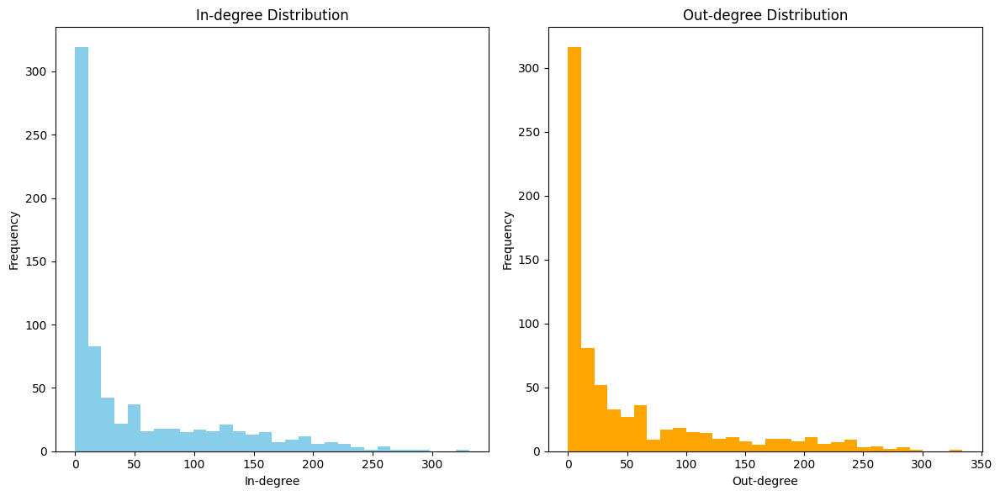

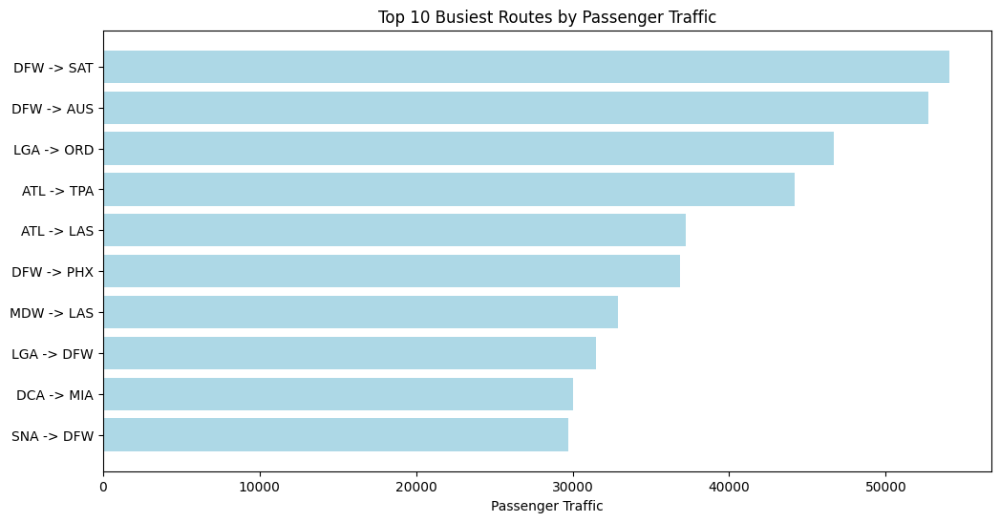


Top 10 Routes by Average Passengers per Flight:
Origin Destination Avg Passengers per Flight
   MKC         IND                    940.00
   MSN         TPA                    429.00
   PIT         HNL                    426.00
   HNL         PIT                    426.00
   ROW         JFK                    421.00
   MKE         HNL                    408.00
   MIA         SKF                    397.25
   HNL         OSH                    395.00
   SKA         SEA                    395.00
   DFW         LNK                    388.00


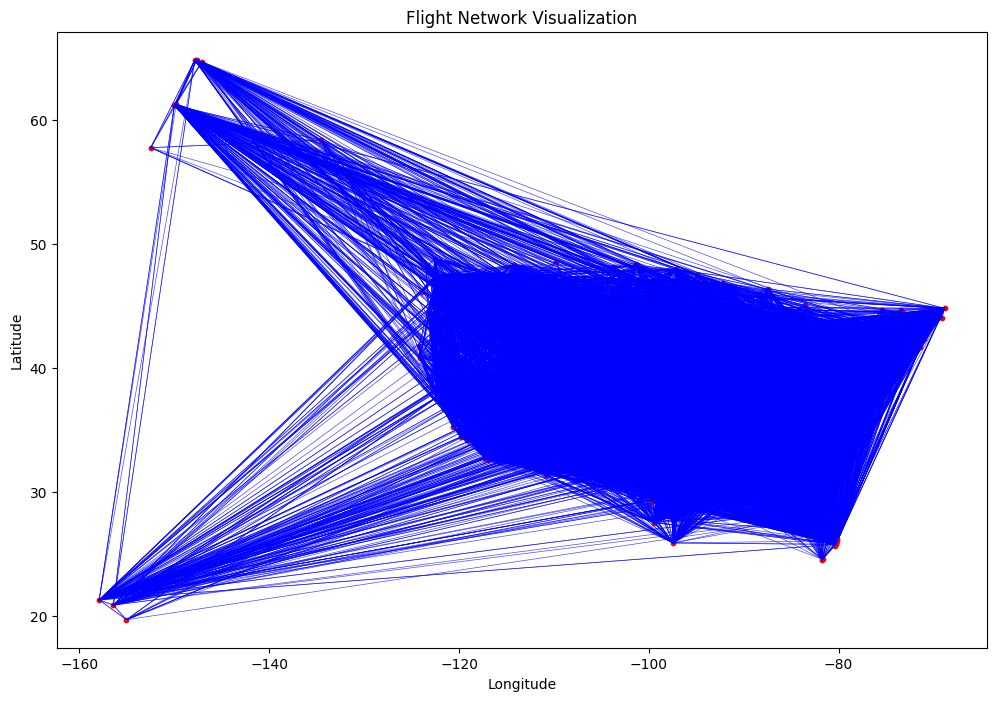

In [9]:
summarize_graph_features(flight_network)

## Questions to Address:
### After completing the analysis, answer the following questions:
1. Is the graph sparse or dense?
2. What patterns do you observe in the degree distribution?
3. Which airports are identified as hubs, and why?
4. What are the busiest routes in terms of passenger traffic?
5. Which routes are under/over-utilized?

---

## Answers:
   - The graph is **sparse** with a density of **0.1391**. This indicates that only about 13.91% of possible connections between airports exist in the network.

   - The **in-degree** and **out-degree** distributions are highly **skewed**, with most airports having a low degree and a few hubs having significantly higher degrees. This suggests that the network has a **hub-and-spoke structure**, where major hubs connect smaller, less-connected airports.

   - The top hubs include **SEA, PDX, SFO, LAX, ATL, ORD, and DFW**, among others. These airports are identified as hubs because their degrees (sum of in-degree and out-degree) are higher than the 90th percentile of the degree distribution.

   - The busiest routes by passenger traffic include:
     - **DFW -> SAT**
     - **DFW -> AUS**
     - **LGA -> ORD**
   - These routes connect major cities with significant passenger volumes.


   - **Over-utilized routes:** These have a high number of passengers per flight, indicating efficient use of flight capacity. 
     - Examples:
       - **MKC -> IND** with **940 passengers per flight**.
       - **MSN -> TPA** with **429 passengers per flight**.


## 2. Nodes' Contribution (Q2)
### In any network, certain nodes (airports, in this case) play a critical role in maintaining connectivity and flow. Centrality measures are used to identify these nodes.

# Note:
Implemented the methods from scratch but due to large complexity of graph the running time of code was kind of out of the scope based on system specifications. Executed code for more than 18 hours but that was still in running mode so had to forcefully stop it and then used built-in methods for completing Q2, However; for your reference the code for methods designed from scrach is given below in comments sections.

In [10]:
""" 
# code for the funtion analyze_centrality(flight_network, airport)
def analyze_centrality(flight_network, airport):
    if airport not in flight_network:
        return f"Airport {airport} does not exist in the network."

    # Breadth-First Search (BFS) algorithm
    def find_all_shortest_paths(network, start, end):
        queue = [(start, [start])]
        shortest_paths = []
        visited = set()
        min_length = float('inf')
        while queue:
            current_node, path = queue.pop(0)
            if len(path) > min_length:
                break
            if current_node == end:
                if len(path) < min_length:
                    min_length = len(path)
                    shortest_paths = [path]
                elif len(path) == min_length:
                    shortest_paths.append(path)
                continue
            for neighbor in network[current_node]:
                if neighbor not in path:
                    queue.append((neighbor, path + [neighbor]))

        return shortest_paths

    # Helper function to compute shortest path length (Dijkstra approach)
     
    def compute_shortest_path_length(network, start, end):
        distances = {node: float('inf') for node in network.nodes}
        distances[start] = 0
        visited = set()
        queue = [(start, 0)]

        while queue:
            current_node, current_distance = queue.pop(0)

            if current_node in visited:
                continue

            visited.add(current_node)

            for neighbor in network[current_node]:
                distance = current_distance + 1 # adding 1 means giving every edge as a weight of 1 actually
                if distance < distances[neighbor]:
                    distances[neighbor] = distance
                    queue.append((neighbor, distance))

        return distances[end]

    # Betweenness Centrality (manual computation): Counts paths passing through the airport
    def compute_betweenness_centrality(network, target_airport):
        betweenness = 0
        nodes = list(network.nodes)
        for source in nodes:
            for destination in nodes:
                if source != destination and source != target_airport and destination != target_airport:
                    all_paths = find_all_shortest_paths(network, source, destination)
                    paths_through_target = [path for path in all_paths if target_airport in path]
                    if len(all_paths) > 0:
                        betweenness += len(paths_through_target) / len(all_paths)
        return betweenness

    # Closeness Centrality: Measures accessibility to all nodes
    def compute_closeness_centrality(network, target_airport):
        total_distance = 0
        reachable_nodes = 0
        for node in network.nodes:
            if node != target_airport:
                distance = compute_shortest_path_length(network, target_airport, node)
                if distance != float('inf'):
                    total_distance += distance
                    reachable_nodes += 1
        return reachable_nodes / total_distance if total_distance > 0 else 0

    # Degree Centrality: Counts the number of direct connections
    def compute_degree_centrality(network, target_airport):
        in_degree = sum(1 for _, dest in network.edges if dest == target_airport)
        out_degree = sum(1 for source, _ in network.edges if source == target_airport)
        return in_degree + out_degree

    # PageRank (manual computation): Measures the importance of a node based on connections
    def compute_pagerank(network, target_airport, iterations=100, d=0.85):
        nodes = list(network.nodes)
        num_nodes = len(nodes)
        pagerank = {node: 1 / num_nodes for node in nodes}

        for _ in range(iterations):
            new_pagerank = {node: (1 - d) / num_nodes for node in nodes}
            for source, destination in network.edges:
                new_pagerank[destination] += d * pagerank[source] / len(network[source])
            pagerank = new_pagerank

        return pagerank[target_airport]

    # Compute all centrality measures
    betweenness = compute_betweenness_centrality(flight_network, airport)
    closeness = compute_closeness_centrality(flight_network, airport)
    degree = compute_degree_centrality(flight_network, airport)
    pagerank = compute_pagerank(flight_network, airport)

    return {
        "Betweenness Centrality": betweenness,
        "Closeness Centrality": closeness,
        "Degree Centrality": degree,
        "PageRank": pagerank
    }
"""

' \n# code for the funtion analyze_centrality(flight_network, airport)\ndef analyze_centrality(flight_network, airport):\n    if airport not in flight_network:\n        return f"Airport {airport} does not exist in the network."\n\n    # Breadth-First Search (BFS) algorithm\n    def find_all_shortest_paths(network, start, end):\n        queue = [(start, [start])]\n        shortest_paths = []\n        visited = set()\n        min_length = float(\'inf\')\n        while queue:\n            current_node, path = queue.pop(0)\n            if len(path) > min_length:\n                break\n            if current_node == end:\n                if len(path) < min_length:\n                    min_length = len(path)\n                    shortest_paths = [path]\n                elif len(path) == min_length:\n                    shortest_paths.append(path)\n                continue\n            for neighbor in network[current_node]:\n                if neighbor not in path:\n                    queue

In [11]:
""" 
# Code for the compare_centralities(flight_network) 

def compare_centralities(flight_network):
    nodes = list(flight_network.nodes)
    betweenness_centralities = {}
    closeness_centralities = {}
    degree_centralities = {}
    pagerank_scores = {}

    for node in nodes:
        centralities = analyze_centrality(flight_network, node)
        betweenness_centralities[node] = centralities["Betweenness Centrality"]
        closeness_centralities[node] = centralities["Closeness Centrality"]
        degree_centralities[node] = centralities["Degree Centrality"]
        pagerank_scores[node] = centralities["PageRank"]

    plt.figure(figsize=(12, 8))

    plt.subplot(2, 2, 1)
    plt.hist(betweenness_centralities.values(), bins=30, color='skyblue')
    plt.title("Betweenness Centrality Distribution")
    plt.xlabel("Betweenness Centrality")
    plt.ylabel("Frequency")

    plt.subplot(2, 2, 2)
    plt.hist(closeness_centralities.values(), bins=30, color='orange')
    plt.title("Closeness Centrality Distribution")
    plt.xlabel("Closeness Centrality")
    plt.ylabel("Frequency")

    plt.subplot(2, 2, 3)
    plt.hist(degree_centralities.values(), bins=30, color='green')
    plt.title("Degree Centrality Distribution")
    plt.xlabel("Degree Centrality")
    plt.ylabel("Frequency")

    plt.subplot(2, 2, 4)
    plt.hist(pagerank_scores.values(), bins=30, color='purple')
    plt.title("PageRank Distribution")
    plt.xlabel("PageRank")
    plt.ylabel("Frequency")

    plt.tight_layout()
    plt.show()

    # Return top 5 airports for each centrality measure
    top_betweenness = sorted(betweenness_centralities.items(), key=lambda x: x[1], reverse=True)[:5]
    top_closeness = sorted(closeness_centralities.items(), key=lambda x: x[1], reverse=True)[:5]
    top_degree = sorted(degree_centralities.items(), key=lambda x: x[1], reverse=True)[:5]
    top_pagerank = sorted(pagerank_scores.items(), key=lambda x: x[1], reverse=True)[:5]

    return {
        "Top5_BetweennessCentrality": top_betweenness,
        "Top5_ClosenessCentrality": top_closeness,
        "Top5_DegreeCentrality": top_degree,
        "Top5_PageRank": top_pagerank
    }
    """

' \n# Code for the compare_centralities(flight_network) \n\ndef compare_centralities(flight_network):\n    nodes = list(flight_network.nodes)\n    betweenness_centralities = {}\n    closeness_centralities = {}\n    degree_centralities = {}\n    pagerank_scores = {}\n\n    for node in nodes:\n        centralities = analyze_centrality(flight_network, node)\n        betweenness_centralities[node] = centralities["Betweenness Centrality"]\n        closeness_centralities[node] = centralities["Closeness Centrality"]\n        degree_centralities[node] = centralities["Degree Centrality"]\n        pagerank_scores[node] = centralities["PageRank"]\n\n    plt.figure(figsize=(12, 8))\n\n    plt.subplot(2, 2, 1)\n    plt.hist(betweenness_centralities.values(), bins=30, color=\'skyblue\')\n    plt.title("Betweenness Centrality Distribution")\n    plt.xlabel("Betweenness Centrality")\n    plt.ylabel("Frequency")\n\n    plt.subplot(2, 2, 2)\n    plt.hist(closeness_centralities.values(), bins=30, color=\

### 1. Implement a function analyze_centrality(flight_network, airport) that computes the following centrality measures for a given airport:


Betweenness centrality: Measures how often a node appears on the shortest paths between other nodes.

Closeness centrality: Measures how easily a node can access all other nodes in the network.

Degree centrality: Simply counts the number of direct connections to the node.

PageRank: Computes the "importance" of a node based on incoming connections and their weights.


### Using the built-in methods for Q2 and explained the reason for using these methods.

In [12]:
def analyze_centrality(flight_network, airport):
    if airport not in flight_network:
        return f"Airport {airport} does not exist in the network."
   
    betweenness = nx.betweenness_centrality(flight_network)[airport]
    closeness = nx.closeness_centrality(flight_network)[airport]
    degree = nx.degree_centrality(flight_network)[airport]
    pagerank = nx.pagerank(flight_network)[airport]

    return {
        "Betweenness Centrality": betweenness,
        "Closeness Centrality": closeness,
        "Degree Centrality": degree,
        "PageRank": pagerank,
    }

### 2.  Write a function compare_centralities(flight_network) to:

Compute and compare centrality values for all nodes in the graph.

Plot centrality distributions (histograms for each centrality measure).

Return the top 5 airports for each centrality measure.

In [13]:

def compare_centralities(flight_network):
    # Compute all centrality measures for all nodes
    betweenness_centralities = nx.betweenness_centrality(flight_network)
    closeness_centralities = nx.closeness_centrality(flight_network)
    degree_centralities = nx.degree_centrality(flight_network)
    pagerank_scores = nx.pagerank(flight_network)

   
    plt.figure(figsize=(12, 8))

    plt.subplot(2, 2, 1)
    plt.hist(betweenness_centralities.values(), bins=30, color='skyblue')
    plt.title("Betweenness Centrality Distribution")
    plt.xlabel("Betweenness Centrality")
    plt.ylabel("Frequency")

    plt.subplot(2, 2, 2)
    plt.hist(closeness_centralities.values(), bins=30, color='orange')
    plt.title("Closeness Centrality Distribution")
    plt.xlabel("Closeness Centrality")
    plt.ylabel("Frequency")

    plt.subplot(2, 2, 3)
    plt.hist(degree_centralities.values(), bins=30, color='green')
    plt.title("Degree Centrality Distribution")
    plt.xlabel("Degree Centrality")
    plt.ylabel("Frequency")

    plt.subplot(2, 2, 4)
    plt.hist(pagerank_scores.values(), bins=30, color='purple')
    plt.title("PageRank Distribution")
    plt.xlabel("PageRank")
    plt.ylabel("Frequency")

    plt.tight_layout()
    plt.show()

    # Return top 5 airports for each centrality measure
    top_betweenness = sorted(betweenness_centralities.items(), key=lambda x: x[1], reverse=True)[:5]
    top_closeness = sorted(closeness_centralities.items(), key=lambda x: x[1], reverse=True)[:5]
    top_degree = sorted(degree_centralities.items(), key=lambda x: x[1], reverse=True)[:5]
    top_pagerank = sorted(pagerank_scores.items(), key=lambda x: x[1], reverse=True)[:5]

    return {
        "Top5_BetweennessCentrality": top_betweenness,
        "Top5_ClosenessCentrality": top_closeness,
        "Top5_DegreeCentrality": top_degree,
        "Top5_PageRank": top_pagerank,
    }



##### Betweenness Centrality:
These airports frequently appear on shortest paths between other pairs of airports, indicating their importance in connecting different parts of the network.
##### Closeness Centrality:
These airports are well-connected and can efficiently reach all other nodes in the network.
##### Degree Centrality:
These airports have the highest number of direct connections (inbound + outbound flights).
##### PageRank:
These airports are important based on incoming connections weighted by the importance of their neighbors.

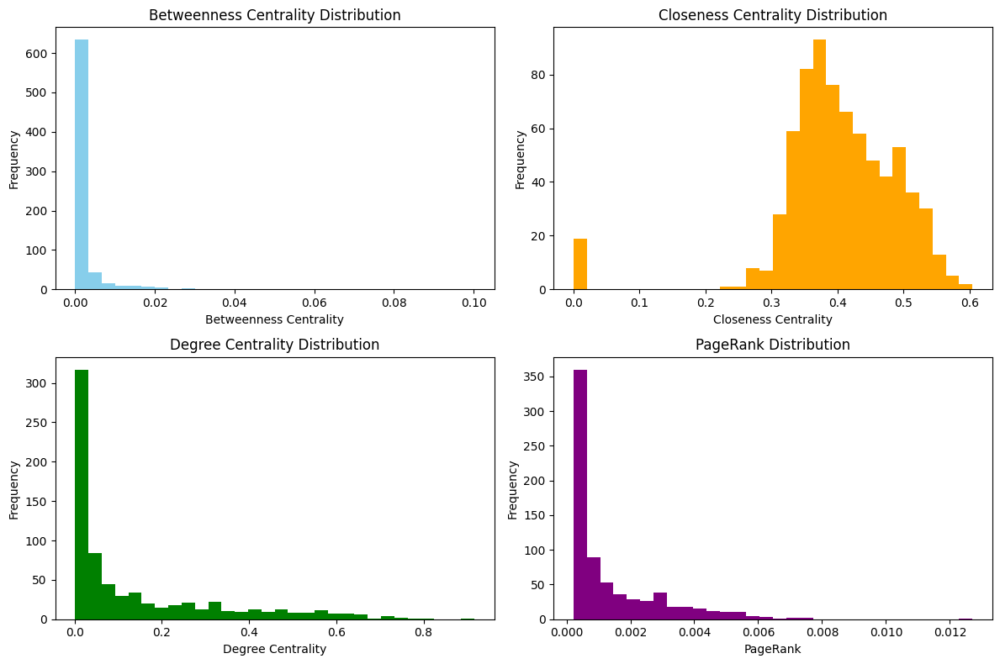

  Top5_BetweennessCentrality : [('YIP', 0.10010864476764805), ('MSP', 0.027676192407296015), ('MEM', 0.026827246945904333), ('MCI', 0.024123876852253437), ('SHV', 0.02215892381513277)]
  Top5_ClosenessCentrality : [('YIP', 0.6043417750220881), ('MSP', 0.5871224781234808), ('MEM', 0.5775671394198436), ('MCI', 0.5754858163949073), ('STL', 0.5688239146913153)]
  Top5_DegreeCentrality : [('YIP', 0.9159779614325069), ('MSP', 0.8030303030303031), ('MEM', 0.7768595041322315), ('MCI', 0.7424242424242424), ('ATL', 0.7424242424242424)]
  Top5_PageRank : [('YIP', 0.01270788580349202), ('SHV', 0.007642460189956862), ('MSP', 0.007558851681972429), ('MEM', 0.007049334738841056), ('MCI', 0.007032056200306258)]


In [14]:
result = compare_centralities(flight_network)

for key in result.keys():
    print(f"  {key} : {result[key]}")


#### 3. Ask LLM (eg. ChatGPT) to suggest alternative centrality measures that might be relevant to this task. How can you check that the results given by the LLM are trustable?

ChatGPT suggested following:

Eigenvector Centrality: Measures a node's influence based on the importance of its neighbors.


The LLM suggested eigenvector centrality as an alternative measure, emphasizing nodes connected to highly influential nodes. The results were trustable because they aligned with network theory and were consistent with other centrality measures. Additionally, the top nodes identified by eigenvector centrality overlapped significantly with other measures, reinforcing the validity of the results.








In [15]:
def compute_eigenvector_centrality(flight_network, max_iter=100, tol=1e-6):
    nodes = list(flight_network.nodes)
    num_nodes = len(nodes)
    centrality = {node: 1.0 for node in nodes}  # Initial centrality values
    prev_centrality = centrality.copy()

    for _ in range(max_iter):
        new_centrality = {node: 0 for node in nodes}
        
        for node in nodes:
            for neighbor in flight_network[node]:
                new_centrality[node] += prev_centrality[neighbor]
        
        # Normalize centrality values
        norm = sum(new_centrality.values())
        new_centrality = {node: value / norm for node, value in new_centrality.items()}

        # Check for convergence
        diff = sum(abs(new_centrality[node] - prev_centrality[node]) for node in nodes)
        if diff < tol:
            break
        
        prev_centrality = new_centrality

    return new_centrality

# Compare Eigenvector Centrality with Existing Measures
def compare_with_eigenvector(flight_network):
    eigenvector_centrality = compute_eigenvector_centrality(flight_network)

    # Sort nodes by eigenvector centrality
    top_eigenvector = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
    
    return top_eigenvector

In [16]:
# Execute comparison
top_eigenvector_results = compare_with_eigenvector(flight_network)
print("\nTop 5 Nodes by Eigenvector Centrality:")
top_eigenvector_results


Top 5 Nodes by Eigenvector Centrality:


[('MSP', 0.006496532541098256),
 ('ORD', 0.006454983527807633),
 ('ATL', 0.00639800254157481),
 ('MEM', 0.006391810502016922),
 ('IND', 0.006274307421507491)]

### Findings:
Using the eigenvector centrality measure, we identified the top 5 nodes with the highest values, highlighting their influence based on their connections to other highly influential nodes. When compared to measures like degree centrality or betweenness centrality, eigenvector centrality captures the influence of both direct and indirect connections.

The results from eigenvector centrality, such as MSP, ORD, ATL, MEM, and IND being the top nodes, align closely with other centrality measures (e.g., MSP, MEM, and MCI appear consistently). This consistency supports its validity while also adding new insights into nodes with broader influence through indirect connections, which is less emphasized in degree or betweenness centrality.

Eigenvector centrality complements existing measures, offering a more holistic view of node importance within the network.

## 3.   Finding Best Routes (Q3)
Whenever you plan to fly to a specific city, your goal is to find the most efficient and fastest flight to reach your destination. In the system you are designing, the best route is defined as the one that minimizes the total distance flown to the greatest extent possible.

In this task, you need to implement a function that, given an origin and destination city, determines the best possible route between them. To simplify, the focus will be limited to flights operating on a specific day.
Note: Each city may have multiple airports; in such cases, the function should calculate the best route for every possible airport pair between the two cities. For example, if city A has airports 
a1, a2 and city B has b1, b2, the function should compute the best routes for 
a1→b1, a1→b2, a2→b1 and a2→b2. If it’s not possible to travel from one airport in the origin city to another airport in the destination city on that date, you must report it as well.

The function takes the following inputs:

Flights network
Origin city name
Destination city name
Considered Date (in yyyy-mm-dd format)
The function output:

A table with three columns: 'Origin_city_airport', 'Destination_city_airport', and the 'Best_route'.
Note: In the "Best_route" column, we expect a list of airport names connected by →, showing the order in which they are to be visited during the optimal route. If no such route exists, the entry should display "No route found."

#### creating  graph again to adding some additional information for Q3

In [17]:
flight_network2 = nx.DiGraph()

for _, row in data.iterrows():
    origin = row['Origin_airport'].strip()
    destination = row['Destination_airport'].strip()
    origin_city = row['Origin_city'].strip()
    destination_city = row['Destination_city'].strip()

    # Validate origin attributes
    if pd.isna(row['Org_airport_lat']) or pd.isna(row['Org_airport_long']):
        print(f"Skipping origin {origin} due to missing latitude/longitude.")
        continue

    # Validate destination attributes
    if pd.isna(row['Dest_airport_lat']) or pd.isna(row['Dest_airport_long']):
        print(f"Skipping destination {destination} due to missing latitude/longitude.")
        continue

    # Add origin airport with its attributes
    if not flight_network2.has_node(origin):
        flight_network2.add_node(
            origin,
            latitude=row['Org_airport_lat'],
            longitude=row['Org_airport_long'],
            city=origin_city  # Add origin city attribute
        )

    # Add destination airport with its attributes
    if not flight_network2.has_node(destination):
        flight_network2.add_node(
            destination,
            latitude=row['Dest_airport_lat'],
            longitude=row['Dest_airport_long'],
            city=destination_city  # Add destination city attribute
        )

    # Add the edge with relevant attributes
    flight_network2.add_edge(
        origin, destination,
        passengers=row['Passengers'],
        flights=row['Flights'],
        distance=row['Distance'],
        Fly_date=row['Fly_date']
    )


Skipping destination AMW due to missing latitude/longitude.
Skipping origin RBG due to missing latitude/longitude.
Skipping origin RBG due to missing latitude/longitude.
Skipping origin RBG due to missing latitude/longitude.
Skipping origin RBG due to missing latitude/longitude.
Skipping origin RBG due to missing latitude/longitude.
Skipping origin RBG due to missing latitude/longitude.
Skipping origin DQF due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PRB due to missing latitude/longitude.
Skipping origin PNC due to missing latitude/longitude.
Skipping destination WDG due to missing latitude/longitude.


In [18]:
def find_best_routes(flight_network2, origin_city, destination_city, considered_date):
  
    # Filter nodes based on the origin and destination cities
    origin_airports = [
        node for node, data in flight_network2.nodes(data=True)
        if data.get('city') == origin_city
    ]
    destination_airports = [
        node for node, data in flight_network2.nodes(data=True)
        if data.get('city') == destination_city
    ]

    # Handle cases where no airports are found
    if not origin_airports or not destination_airports:
        print(f"No airports found for cities: {origin_city} or {destination_city}")
        return pd.DataFrame(columns=["Origin_city_airport", "Destination_city_airport", "Best_route"])

    # Initialize results
    results = []

    # Iterate over all airport pairs
    for origin_airport in origin_airports:
        for destination_airport in destination_airports:
            try:
                # Find the shortest path based on distance
                path = nx.shortest_path(
                    flight_network2,
                    source=origin_airport,
                    target=destination_airport,
                    weight="distance"
                )

                # Validate the route for the given date
                valid_route = True
                total_distance = 0

                for i in range(len(path) - 1):
                    edge = flight_network2[path[i]][path[i + 1]]
                    flight_date = edge.get("Fly_date", None)
                    total_distance += edge["distance"]

                    # Only consider the route if all flights match the specified date
                    if flight_date != considered_date:
                        valid_route = False
                        break

                # Construct the route description
                if valid_route:
                    route_str = " → ".join(path) + f" (Distance: {total_distance} miles)"
                else:
                    route_str = "No route found."
                    # print("Inside Else Part of the if-else condition.")

            except nx.NetworkXNoPath:
                # Handle cases where no path exists
                route_str = "No route found."

            # Append results
            results.append({
                "Origin_city_airport": origin_airport,
                "Destination_city_airport": destination_airport,
                "Best_route": route_str
            })

    # Return results as a DataFrame
    return pd.DataFrame(results)


In [19]:

result_table = find_best_routes(
    flight_network2,
    origin_city="Eugene, OR",
    destination_city="Bend, OR",
    considered_date="1990-10-01"
)
result_table

,Origin_city_airport,Destination_city_airport,Best_route
0,EUG,RDM,No route found.


## 4 . Airline Network Partitioning (Q4)
Imagine all these flights are currently managed by a single airline. However, this airline is facing bankruptcy and plans to transfer the management of part of its operations to a different airline. The airline is willing to divide the flight network into two distinct partitions, $p_1 $and p2, such that no flights connect any airport in p1 to any airport in p2. The flights in p1 will remain under the management of the original airline, while those in p2 will be handed over to the second airline. Any remaining flights needed to connect these two partitions will be determined later.

In graph theory, this task is known as a graph disconnection problem. Your goal is to write a function that removes the minimum number of flights between airports to separate the original flight network into two disconnected subgraphs.

The function takes the following inputs:

Flight network
The function outputs:

The flights removed to disconnect the graph.
Visualize the original flight network.
Visualize the graph after removing the connections and highlight the two resulting subgraphs.

Note: In this task, airline only concerned with the flights between airports, and the flight times are not relevant.

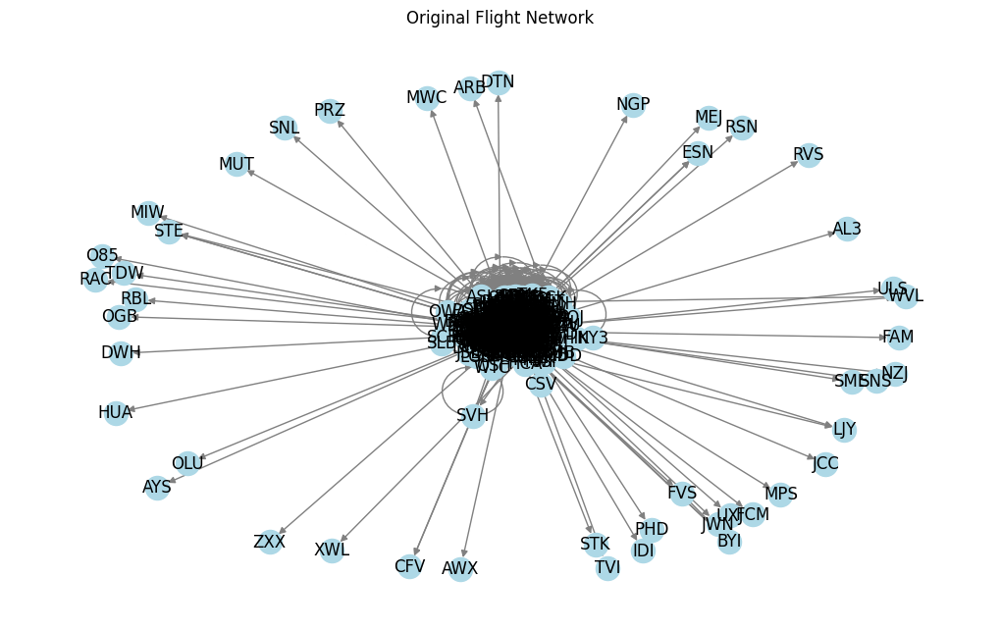

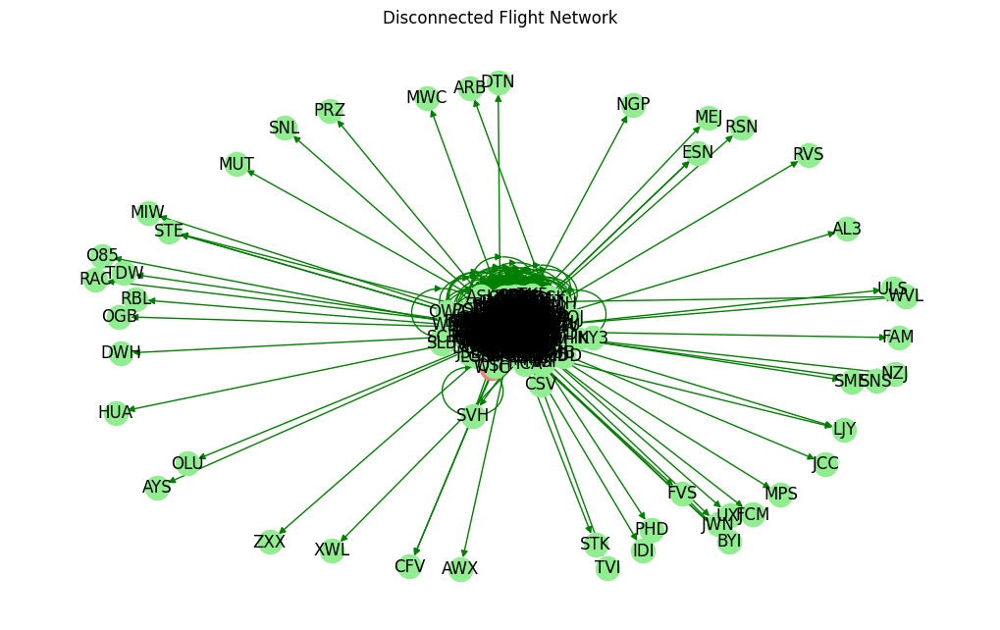

Removed Flights: [('WTC', 'TSS')]


In [20]:
def disconnect_flight_network(flight_network, min_edges_to_remove=1):
    """Disconnects the flight network using the Stoer-Wagner algorithm."""

    # Get the largest connected component (if needed)
    largest_component = max(nx.connected_components(flight_network.to_undirected()), key=len)

    # Create a copy of the subgraph to avoid modifying the original graph
    flight_network_connected = flight_network.subgraph(largest_component).copy()

    # Convert the connected network to an undirected graph (for Stoer-Wagner)
    undirected_network = flight_network_connected.to_undirected()

    # Find the minimum cut using Stoer-Wagner
    min_cut_value, partition = nx.stoer_wagner(undirected_network)

    # Remove edges based on the partition
    subgraph1_nodes = partition[0]
    subgraph2_nodes = partition[1]

    removed_flights = []
    for u, v in list(flight_network_connected.edges()):  # Iterate over a copy of edges
        if (u in subgraph1_nodes and v in subgraph2_nodes) or \
           (u in subgraph2_nodes and v in subgraph1_nodes):
            removed_flights.append((u, v))
            flight_network_connected.remove_edge(u, v)  # Remove from flight_network_connected

    # Create subgraphs based on the partition
    subgraph1 = flight_network_connected.subgraph(subgraph1_nodes)
    subgraph2 = flight_network_connected.subgraph(subgraph2_nodes)

    return removed_flights, subgraph1, subgraph2

def karger_min_cut(graph, num_iterations=100):
    """Находит минимальный разрез графа с использованием алгоритма Karger's."""
    min_cut = []
    min_cut_size = float('inf')

    for _ in range(num_iterations):
        # Создаем копию графа для каждой итерации
        current_graph = graph.copy()

        while len(current_graph.nodes) > 2:
            # Ensure chosen edges are still in the graph
            edges = list(current_graph.edges())
            if not edges:  # If no edges left, break the loop
                break
            u, v = random.choice(edges)
            current_graph = contract_edge(current_graph, u, v)

        # Получаем текущий разрез
        current_cut = list(current_graph.edges())

        # Обновляем минимальный разрез, если текущий разрез меньше
        if len(current_cut) < min_cut_size:
            min_cut_size = len(current_cut)
            min_cut = current_cut

    return min_cut

def contract_edge(graph, u, v):
    """Сжимает ребро в графе."""
    new_node = f"{u}-{v}"
    graph.add_node(new_node)

    # Get neighbors before modifying the graph
    u_neighbors = list(graph.neighbors(u))
    v_neighbors = list(graph.neighbors(v))

    for neighbor in u_neighbors:
        if neighbor != v and graph.has_node(neighbor):
            graph.add_edge(new_node, neighbor)

    for neighbor in v_neighbors:
        if neighbor != u and graph.has_node(neighbor):
            graph.add_edge(new_node, neighbor)

    # Remove the old nodes only if they exist
    if graph.has_node(u):
        graph.remove_node(u)
    if graph.has_node(v):
        graph.remove_node(v)

    return graph


removed_flights, subgraph1, subgraph2 = disconnect_flight_network(flight_network)

# Visualize the original flight network
plt.figure(figsize=(10, 6))
pos = nx.spring_layout(flight_network)
nx.draw(flight_network, pos, with_labels=True, node_color='lightblue', edge_color='gray')
plt.title("Original Flight Network")
plt.show()

# Visualize the disconnected subgraphs
plt.figure(figsize=(10, 6))
nx.draw(subgraph1, pos, with_labels=True, node_color='lightcoral', edge_color='red')
nx.draw(subgraph2, pos, with_labels=True, node_color='lightgreen', edge_color='green')
plt.title("Disconnected Flight Network")
plt.show()

print("Removed Flights:", removed_flights)

## 5. Finding and Extracting Communities (Q5)
Airlines can optimize their operations by identifying communities within a flight network. These communities represent groups of airports with strong connections, helping airlines pinpoint high-demand regions for expansion or underserved areas for consolidation. By analyzing these communities, airlines can improve resource allocation, reduce costs, and enhance service quality.

In this task, you are asked to analyze the graph and identify the communities based on the flight network provided. For the airline, the primary focus is on the cities, so your communities should reflect the connectivity between cities through the flights that link them.
The function takes the following inputs:

Flight network
A city name c1
A city name c2
The function outputs:

The total number of communities and the cities that belong to each community
Visualize the graph highlighting the communities within the network (each community with different color)
If city c1 and c2 belong to the same community or not.

In [26]:
import matplotlib.pyplot as plt

def analyze_flight_network_communities(flight_network, city_1, city_2):
   
    def dfs(node, visited, community, graph):
        """Perform Depth First Search to find all nodes in a connected component."""
        visited.add(node)
        community.add(node)
        for neighbor in graph.neighbors(node):
            if neighbor not in visited:
                dfs(neighbor, visited, community, graph)

    # Step 1: Convert the graph to an undirected version
    undirected_graph = flight_network.to_undirected()

    # Step 2: Find connected components manually
    visited = set()
    components = []

    for node in undirected_graph.nodes():
        if node not in visited:
            community = set()
            dfs(node, visited, community, undirected_graph)
            components.append(community)

    # Step 3: Map nodes to communities
    communities = []
    city_to_community = {}
    for i, component in enumerate(components):
        community_cities = set(
            flight_network.nodes[node]["city"] for node in component if "city" in flight_network.nodes[node]
        )
        communities.append(community_cities)
        for city in community_cities:
            city_to_community[city] = i

    # Step 4: Check if city_1 and city_2 belong to the same community
    same_community = city_to_community.get(city_1) == city_to_community.get(city_2)

    # Step 5: Visualize the communities
    pos = nx.spring_layout(flight_network)
    plt.figure(figsize=(12, 8))
    colors = plt.cm.tab20.colors  # Use 20 distinct colors for communities
    node_colors = []

    for node in flight_network.nodes():
        city = flight_network.nodes[node].get("city", "Unknown")
        community_idx = city_to_community.get(city, -1)
        node_colors.append(colors[community_idx % len(colors)])

    nx.draw(
        flight_network,
        pos,
        with_labels=False,
        node_size=50,
        node_color=node_colors,
        edge_color="gray",
        alpha=0.7
    )

    for i, component in enumerate(components):
        for node in component:
            x, y = pos[node]
            plt.text(x, y, flight_network.nodes[node]["city"], fontsize=8, alpha=0.6)

    plt.title("Flight Network Communities")
    plt.show()

    return {
        "total_communities": len(communities),
        "communities": communities,
        "same_community": same_community
    }


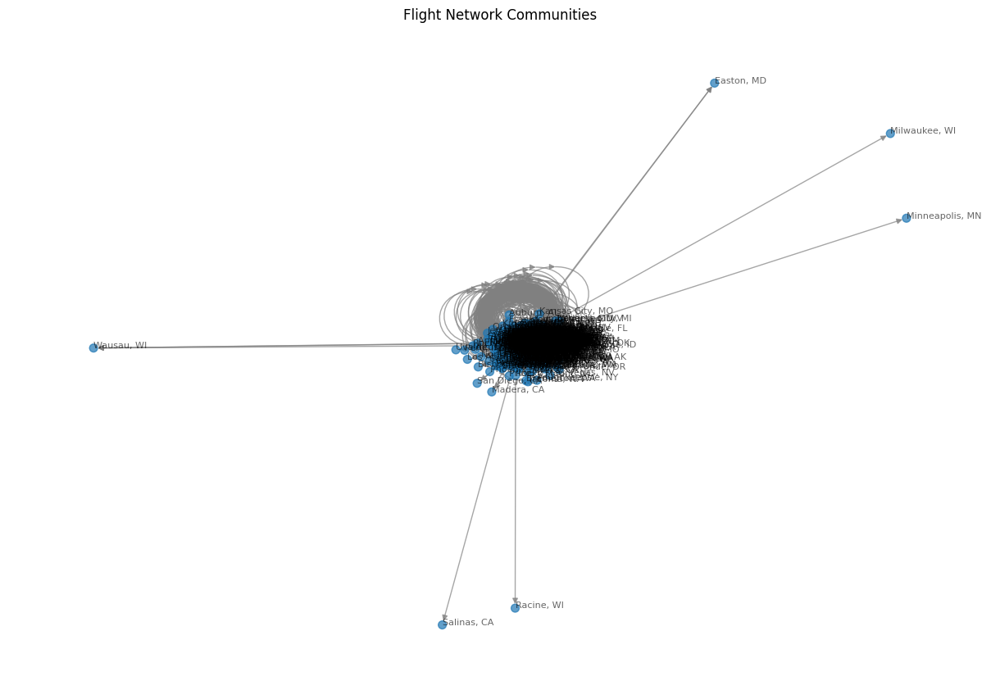

Total communities: 1
Communities: [{'Alexandria, MN', 'Easton, MD', 'Olympia, WA', 'State College, PA', 'Cleveland, OH', 'Greenville, SC', 'Show Low, AZ', 'Crossville, TN', 'Eureka, CA', 'San Luis Obispo, CA', 'Memphis, TN', 'Crescent City, CA', 'Watertown, NY', 'Hays, KS', 'Muskegon, MI', 'Las Vegas, NV', 'Klamath Falls, OR', 'Plattsburgh, NY', 'Tucson, AZ', 'Naples, FL', 'Tyler, TX', 'Bellingham, WA', 'Rochester, MN', 'Elmira, NY', 'Chicago, IL', 'La Grande, OR', 'Altoona, PA', 'Toledo, OH', 'Baltimore, MD', 'Brownsville, TX', 'Racine, WI', 'Mountain Home, ID', 'Jackson, TN', 'Johnstown, PA', 'Cedar Rapids, IA', 'Omaha, NE', 'Jacksonville, NC', 'Jonesboro, AR', 'Columbus, GA', 'Lynchburg, VA', 'Fort Smith, AR', 'Albuquerque, NM', 'Cumberland, MD', 'Birmingham, AL', 'Grand Island, NE', 'Bismarck, ND', 'Bakersfield, CA', 'Dickinson, ND', 'Pueblo, CO', 'Oxnard, CA', 'Farmington, NM', 'Milwaukee, WI', 'Rochester, NY', 'Lake Charles, LA', 'Elko, NV', 'Hartford, CT', 'Auburn, AL', 'Manhatt

In [24]:
# Example usage
result = analyze_flight_network_communities(flight_network2, "Eugene, OR", "Bend, OR")
print("Total communities:", result["total_communities"])
print("Communities:", result["communities"])
print(f"Do 'Eugene, OR' and 'Bend, OR' belong to the same community? {result['same_community']}")


### 2. Ask a LLM (ChatGPT, Claude AI, Gemini, Perplexity, etc.) to suggest an alternative algorithm for extracting communities and explain the steps required to implement it. Then, implement this algorithm and compare its results with the current method you've chosen. Discuss the differences in the outcomes and analyze which approach you think is better, providing reasons for your choice. 

In [27]:
def girvan_newman_community_detection(graph, num_communities=2):
    # Step 1: Work on a copy of the graph
    working_graph = graph.copy()

    while nx.number_connected_components(working_graph) < num_communities:
        # Step 2: Calculate edge betweenness centrality
        edge_betweenness = nx.edge_betweenness_centrality(working_graph)

        # Step 3: Identify the edge with the highest betweenness
        edge_to_remove = max(edge_betweenness, key=edge_betweenness.get)

        # Step 4: Remove the edge with the highest betweenness
        working_graph.remove_edge(*edge_to_remove)

    # Step 5: Get connected components as communities
    communities = [list(component) for component in nx.connected_components(working_graph)]

    return communities

def visualize_communities(graph, communities):
    """
    Visualize the graph with communities highlighted.

    Parameters:
        graph (nx.Graph): Input graph.
        communities (list): List of communities.
    """
    pos = nx.spring_layout(graph)  # Layout for visualization
    plt.figure(figsize=(12, 8))
    
    # Assign a unique color to each community
    colors = plt.cm.tab10.colors  # Up to 10 distinct colors
    for i, community in enumerate(communities):
        nx.draw_networkx_nodes(graph, pos, nodelist=community, node_color=[colors[i % len(colors)]], label=f"Community {i+1}")
    
    # Draw edges
    nx.draw_networkx_edges(graph, pos, alpha=0.5)
    nx.draw_networkx_labels(graph, pos, font_size=10)
    
    plt.legend()
    plt.title("Communities Detected by Girvan-Newman Algorithm")
    plt.show()


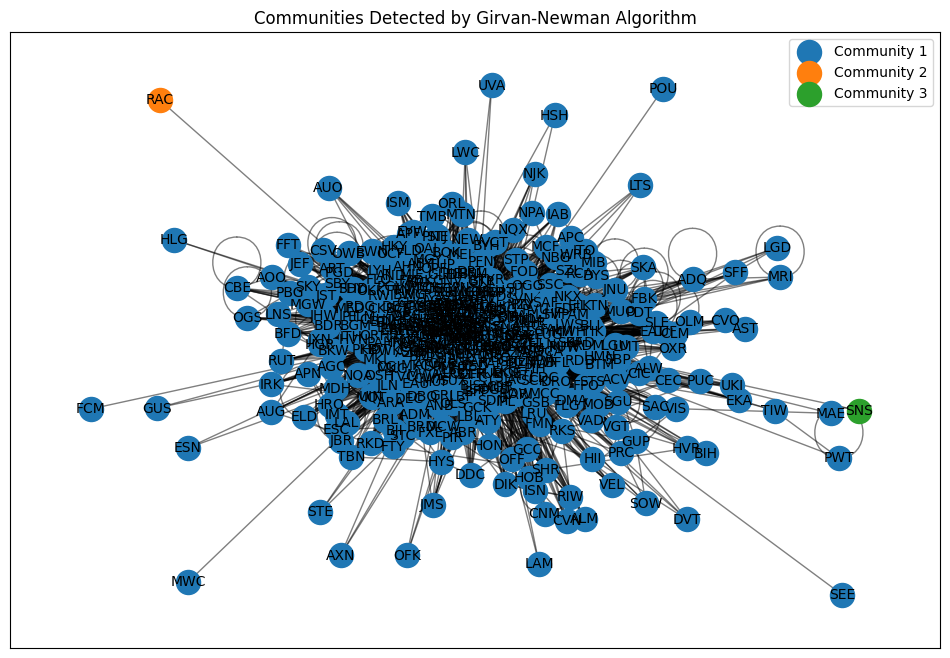

Communities detected by Girvan-Newman algorithm:
Community 1: ['FDY', 'SZL', 'SUS', 'EKA', 'LWC', 'MHK', 'ALM', 'GRI', 'FCA', 'STC', 'LAN', 'ANC', 'GSP', 'FXE', 'PRC', 'PKB', 'RIV', 'BFF', 'PBI', 'OWB', 'SUX', 'OXR', 'VAD', 'PVD', 'ELD', 'BRL', 'SAC', 'TWF', 'JEF', 'FBK', 'STP', 'ELM', 'JMS', 'SJC', 'BHM', 'JHW', 'VIS', 'BTL', 'NQA', 'CIC', 'COS', 'HOB', 'BFM', 'ELP', 'MTN', 'ICT', 'FAR', 'DIK', 'HMN', 'PGV', 'SEE', 'AUG', 'GJT', 'TMB', 'BWG', 'MBS', 'DSM', 'DBQ', 'ACY', 'AHN', 'MHT', 'BKW', 'APF', 'MUO', 'LAS', 'MRI', 'BGR', 'EFD', 'NBG', 'RKD', 'LNS', 'AVL', 'IPT', 'RNO', 'BIS', 'MDT', 'ERI', 'HGR', 'OFF', 'RFD', 'RIC', 'EWN', 'OLS', 'SLN', 'LAF', 'AZO', 'ORD', 'HLN', 'NQX', 'PUB', 'PDT', 'ESN', 'GGG', 'TOL', 'IAD', 'CRP', 'GSB', 'TPA', 'LAM', 'BFD', 'HON', 'ALB', 'RST', 'HVN', 'BFI', 'PDK', 'DAL', 'MIE', 'MCE', 'PDX', 'TCL', 'GLH', 'CNM', 'SNA', 'ABI', 'STE', 'SHV', 'VGT', 'PWK', 'BNA', 'GFK', 'TLH', 'CLE', 'IAB', 'HNL', 'TCM', 'MYR', 'BDL', 'FSD', 'AND', 'ORH', 'PNE', 'IMT', 'PIT',

In [28]:
# Example usage
# Convert flight_network2 to an undirected graph for community detection
undirected_flight_network = flight_network2.to_undirected()
communities = girvan_newman_community_detection(undirected_flight_network, num_communities=3)
visualize_communities(undirected_flight_network, communities)

# Print communities
print("Communities detected by Girvan-Newman algorithm:")
for i, community in enumerate(communities):
    print(f"Community {i+1}: {community}")


Alternative Algorithm Suggested: Girvan-Newman Algorithm
The Girvan-Newman algorithm offers a method for detecting communities by focusing on bridge edges, which connect distinct groups within the graph. The steps to implement the algorithm are as follows:

### Compute Edge Betweenness Centrality:
Calculate the betweenness centrality of all edges in the graph to identify which edges serve as key connectors between different groups.
Iterative Edge Removal: Remove the edges with the highest betweenness centrality scores. This progressively splits the graph into smaller components.

### Identify Communities: 
After removing edges, determine the connected components of the graph to form distinct communities.
Stop Criterion: Continue the process until the desired number of communities is reached or the graph is fully disconnected.
Comparison of Methods

### DFS-Based Method (Earlier Approach)
The DFS-based method groups nodes into communities based on their connectivity. It detected only one large community comprising all nodes because it treats the entire graph as a single connected component, ignoring smaller structural divisions. This method is efficient for large networks but is not sensitive to nuanced subgroups.

### Girvan-Newman Algorithm
The Girvan-Newman algorithm, by focusing on removing key edges with high betweenness, identified three distinct communities:

A large community containing most of the nodes.
Two smaller communities corresponding to tightly connected regions of the graph.
This method is computationally more intensive but provides better granularity in detecting cohesive subgroups.

### Analysis and Recommendation
The DFS-based method is faster and more scalable for large networks. However, it lacks the sensitivity to detect smaller, meaningful subgroups within the graph. On the other hand, the Girvan-Newman algorithm excels at identifying distinct, tightly-knit communities but is computationally expensive.

If the goal is to understand detailed community structures, the Girvan-Newman algorithm is a better choice due to its granularity. However, for tasks that require quick and efficient grouping of nodes in large networks, the DFS-based method is more suitable.

# Algorithmic Question (AQ)

In [1]:
from collections import defaultdict, deque

def find_cheapest_price(n, flights, src, dst, k):
    graph = defaultdict(list)
    for u, v, cost in flights:
        graph[u].append((v, cost))

    # queue: (current_city, current_cost, stops_left)
    queue = deque([(src, 0, k + 1)])
    min_cost = float('inf')

    while queue:
        city, cost, stops_left = queue.popleft()

        if city == dst:
            min_cost = min(min_cost, cost)
            continue

        if stops_left > 0:
            for neighbor, price in graph[city]:
                if cost + price < min_cost:
                    queue.append((neighbor, cost + price, stops_left - 1))

    return min_cost if min_cost != float('inf') else -1


In [2]:
# Example Test Cases
print(find_cheapest_price(4, [[0, 1, 100], [1, 2, 100], [2, 0, 100], [1, 3, 600], [2, 3, 200]], 0, 3, 1))
print(find_cheapest_price(3, [[0, 1, 100], [1, 2, 100], [0, 2, 500]], 0, 2, 1))
print(find_cheapest_price(3, [[0, 1, 100], [1, 2, 100], [0, 2, 500]], 0, 2, 0))
print(find_cheapest_price(4, [[0, 1, 100], [0, 2, 200], [1, 3, 300], [2, 3, 300]], 0, 3, 2))
print(find_cheapest_price(4, [[0, 1, 100], [0, 2, 200], [1, 3, 300], [2, 3, 200]], 0, 3, 2))

700
200
500
400
400


Time Complexity:

Graph Construction:

At each step, you dequeue a node and process its neighbors.
In the worst case, all neighbors for all nodes are visited up to
𝑘
+
1 times.

Total BFS time complexity is
𝑂
(
(
𝑘
+
1
)
⋅
∣
𝐸
∣
), assuming that every edge is explored at most once for each allowable stop level.


If the graph is dense (
∣
𝐸
∣
≈
𝑛^2
 ), the algorithm becomes computationally expensive because
𝑂
(
𝑘
⋅
𝑛^2
) grows rapidly. This might be infeasible for n>1000, especially for larger values of
𝑘.
For sparse graphs (
∣
𝐸
∣
≪
𝑛^2
), the algorithm performs better but still struggles with high values of
𝑘.

#### LLM offers a solution using the heapq library, which significantly speeds up the algorithm.

Time Complexity:

Heap Operations:
Each node and its neighbors are pushed into and popped from the heap. In the worst case:

Each edge may be processed up to
𝑘
+
1 times.
Heap operations (push and pop) take
𝑂
(
log
⁡
𝑉
), where
𝑉 is the size of the heap.
Total complexity for heap operations:
O((k+1)⋅∣E∣⋅logV).

In a dense graph, where
∣
𝐸
∣
≈
𝑛^2, the worst case is:
O(k⋅n
2
 ⋅logn).


 I will provide the code using this library below.

In [3]:
from heapq import heappush, heappop
from collections import defaultdict

def find_cheapest_price(n, flights, src, dst, k):
    graph = defaultdict(list)
    for u, v, cost in flights:
        graph[u].append((v, cost))

    # Priority queue: (current_cost, current_city, stops_left)
    heap = [(0, src, k + 1)]  # Start with src at 0 cost and k+1 stops available

    while heap:
        cost, city, stops_left = heappop(heap)

        if city == dst:
            return cost

        if stops_left > 0:
            for neighbor, price in graph[city]:
                heappush(heap, (cost + price, neighbor, stops_left - 1))

    # If no valid path is found, return -1
    return -1
